# Cell Segmentation with Voyager

Based on the following tutorials:
* https://pachterlab.github.io/voyager/articles/visium_10x.html
* https://pachterlab.github.io/voyager/articles/vig1_visium_basic.html
* https://pachterlab.github.io/voyager/articles/vig2_visium.html
* https://pachterlab.github.io/voyager/articles/visium_10x_spatial.html

In [1]:
library(dplyr)
library(Voyager)
library(SpatialExperiment)
library(SpatialFeatureExperiment)
library(SingleCellExperiment)
library(ggplot2)
library(scater)
library(rlang)
library(scuttle)
library(terra)
library(sf)
library(rmapshaper)
# library(scran)
library(stringr)
library(EBImage)
library(patchwork)
library(bluster)
library(rjson)
theme_set(theme_bw())


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: SpatialFeatureExperiment


Attaching package: ‘SpatialFeatureExperiment’


The following object is masked from ‘package:base’:

    scale


Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:dplyr’:

    count



Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrde

In [2]:
# Layout
custom_theme <- function() {
  theme_bw() +
    theme(
      legend.text = element_text(size = 14),
      legend.title = element_text(size = 16, face = "bold"),
      axis.text = element_text(size = 12),
      axis.title = element_text(size = 14, face = "bold"),
      legend.position = "right",
      legend.box.just = "right"
    )
}
options(repr.plot.width = 20, repr.plot.height = 16)

In [3]:
data_dir <- R.utils::getAbsolutePath('../../data')
mouse_dir <- glue::glue("{data_dir}/Visium_Mouse_Olfactory_Bulb/outs")

## Visium Files

### Scale Factors

The scalefactors_json.json file contains image metadata:
* **tissue_hires_scalef** and **tissue_lowres_scalef** are the ratio of the size of the high resolution (but not full resolution) and low resolution H&E image to the full resolution image.
* **fiducial_diameter_fullres** is the diameter of each fiducial spot used to align the spots to the H&E image in pixels in the full resolution image.
* **spot_diameter_fullres** is the diameter of each Visium spot in the full resolution H&E image in pixels. 

In [4]:
scale_factors <- fromJSON(file = glue::glue("{mouse_dir}/spatial/scalefactors_json.json"))
scale_factors

$tissue_hires_scalef
[1] 0.2

$tissue_lowres_scalef
[1] 0.06

$fiducial_diameter_fullres
[1] 118.9155

$spot_diameter_fullres
[1] 73.61433

### Tissue Metadata

The tissue_positions_list.csv file contains information about each spot/barcode:
* **in_tissue** indicates whether each spot is in tissue (in_tissue, 1 means yes and 0 means no) as automatically detected by 
Space Ranger or manually annotated in the Loupe browser.
* **array_row** and **array_col** are the coordinates on the matrix of spots,
* **pxl_row_in_fullres** and **pxl_col_in_fullres** are the coordinates of the spots in the full resolution 
image.

In [5]:
head(read.csv(glue::glue("{mouse_dir}/spatial/tissue_positions.csv")))

,barcode,in_tissue,array_row,array_col,pxl_row_in_fullres,pxl_col_in_fullres
,<chr>,<int>,<int>,<int>,<int>,<int>
1,ACGCCTGACACGCGCT-1,0,0,0,8668,1102
2,TACCGATCCAACACTT-1,0,1,1,8611,1200
3,ATTAAAGCGGACGAGC-1,0,0,2,8554,1102
4,GATAAGGGACGATTAG-1,0,1,3,8498,1200
5,GTGCAAATCACCAATA-1,0,0,4,8441,1102
6,TGTTGGCTGGCGGAAG-1,0,1,5,8384,1200


## Read Visium Data

In [6]:
raw_sfe <- SpatialFeatureExperiment::read10xVisiumSFE(dirs = mouse_dir, samples = ".", type = "sparse", data = "raw")

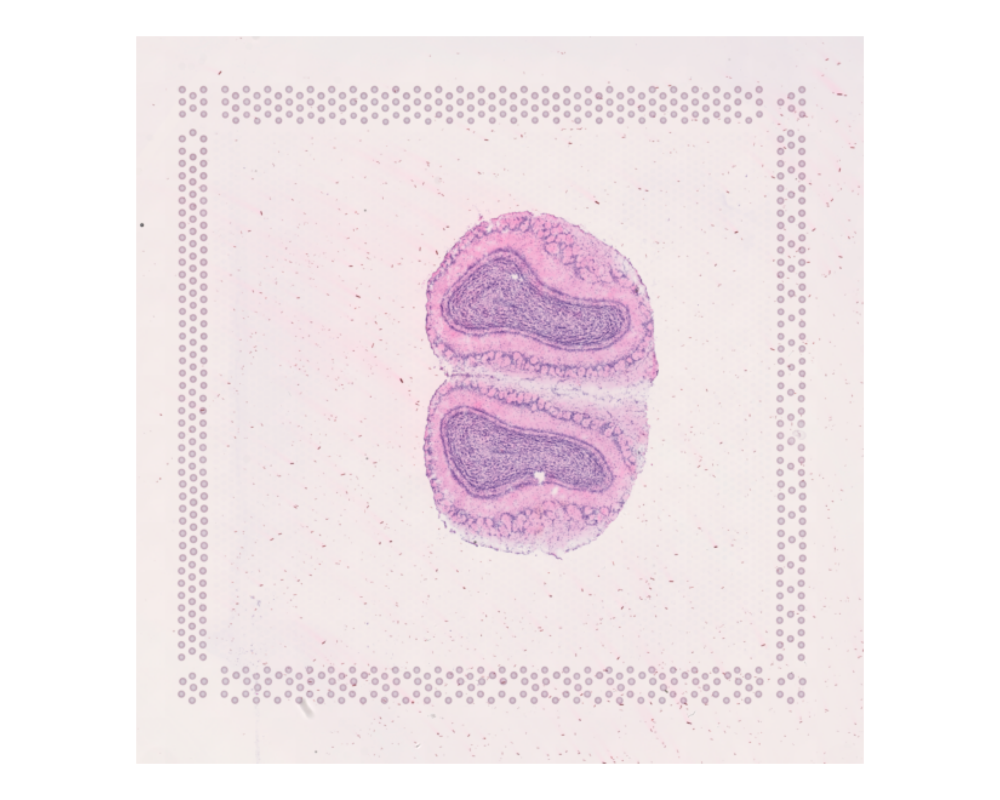

In [7]:
Voyager::plotImage(raw_sfe)

## Read Hi-res Image

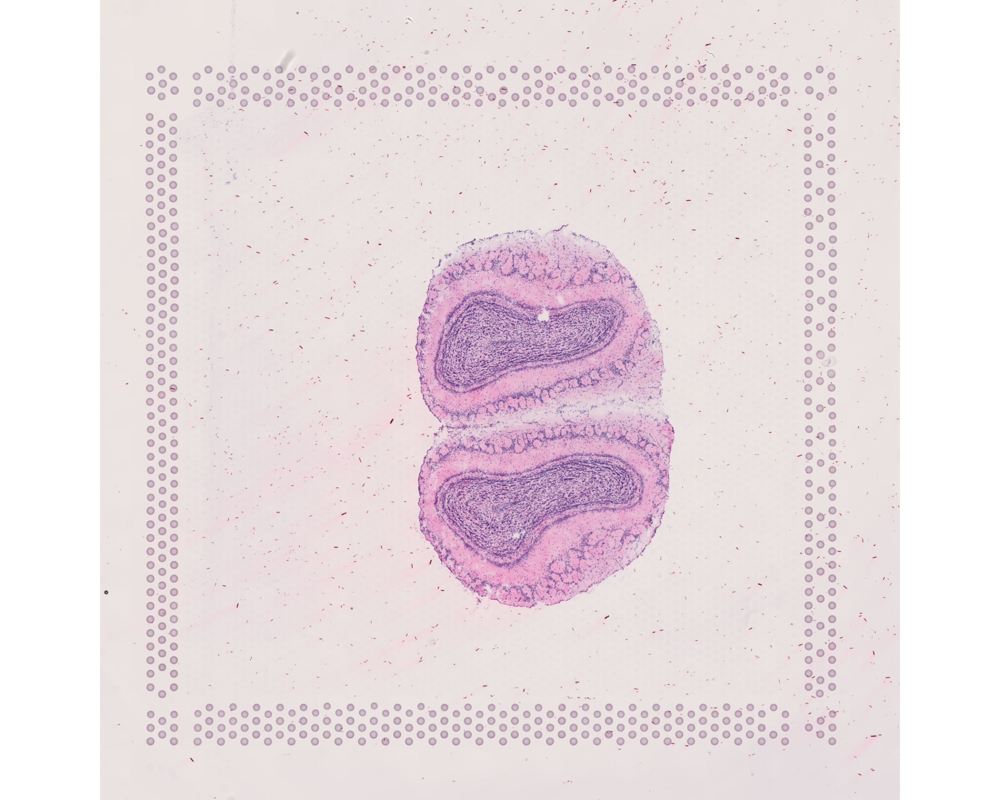

In [8]:
img <- readImage(glue::glue("{mouse_dir}/spatial/tissue_hires_image.png"))
EBImage::display(img)

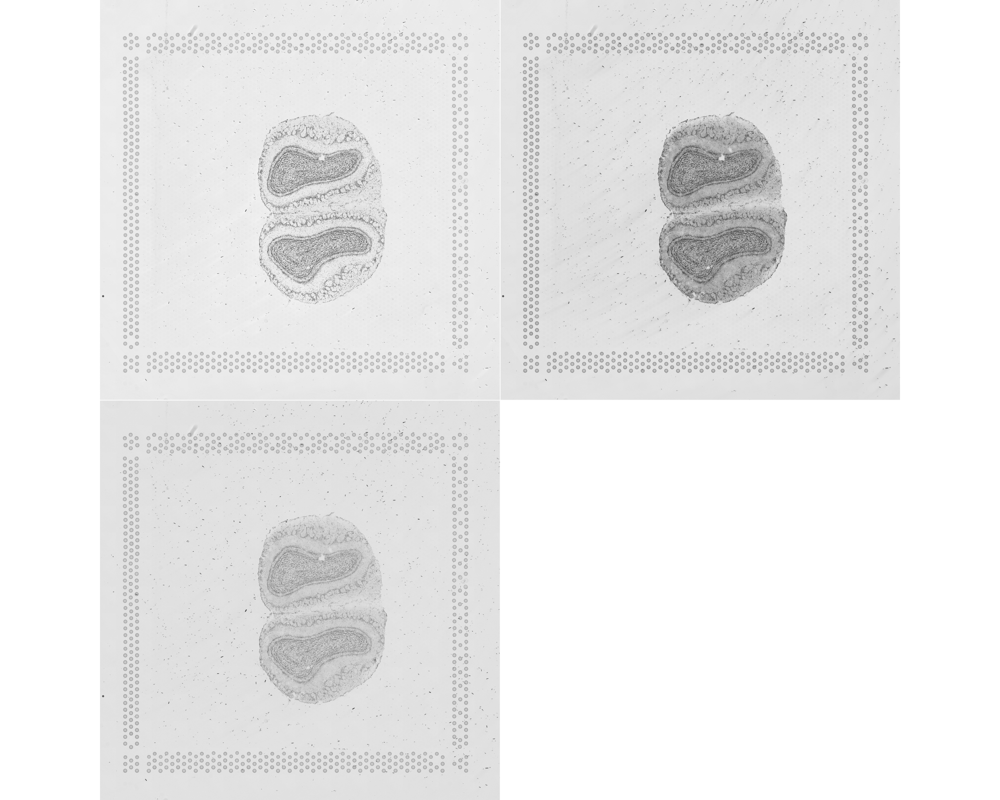

NULL

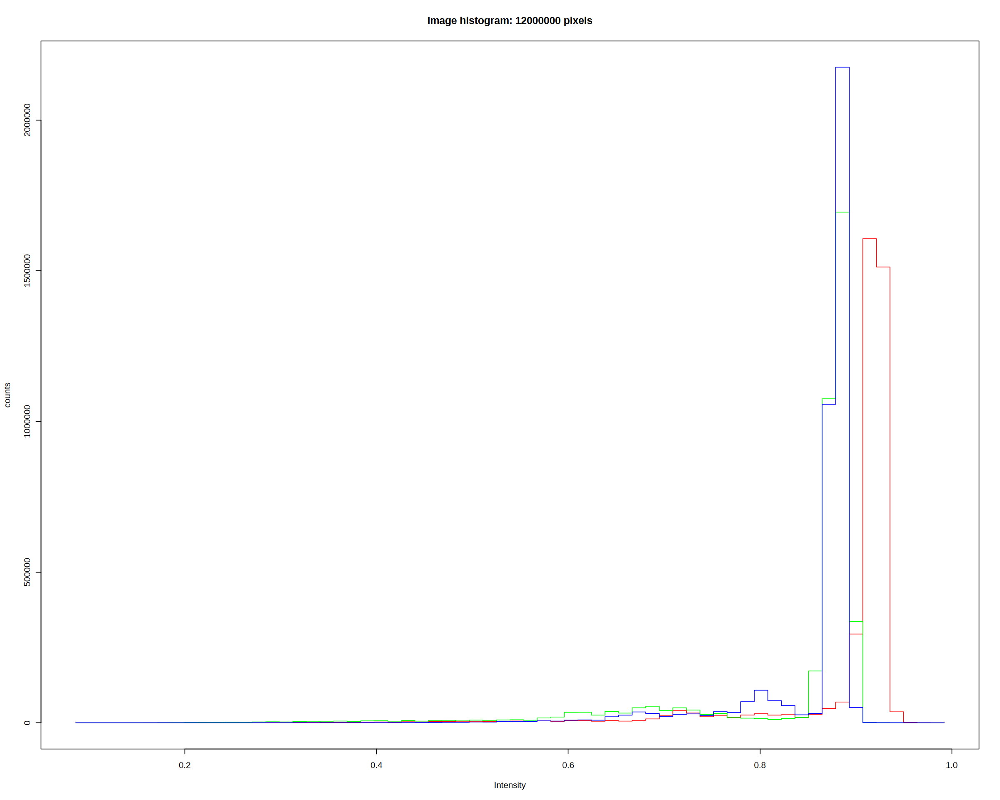

In [9]:
img2 <- img
EBImage::colorMode(img2) <- EBImage::Grayscale
EBImage::display(img2, all = TRUE)
(EBImage::hist(img) + custom_theme())

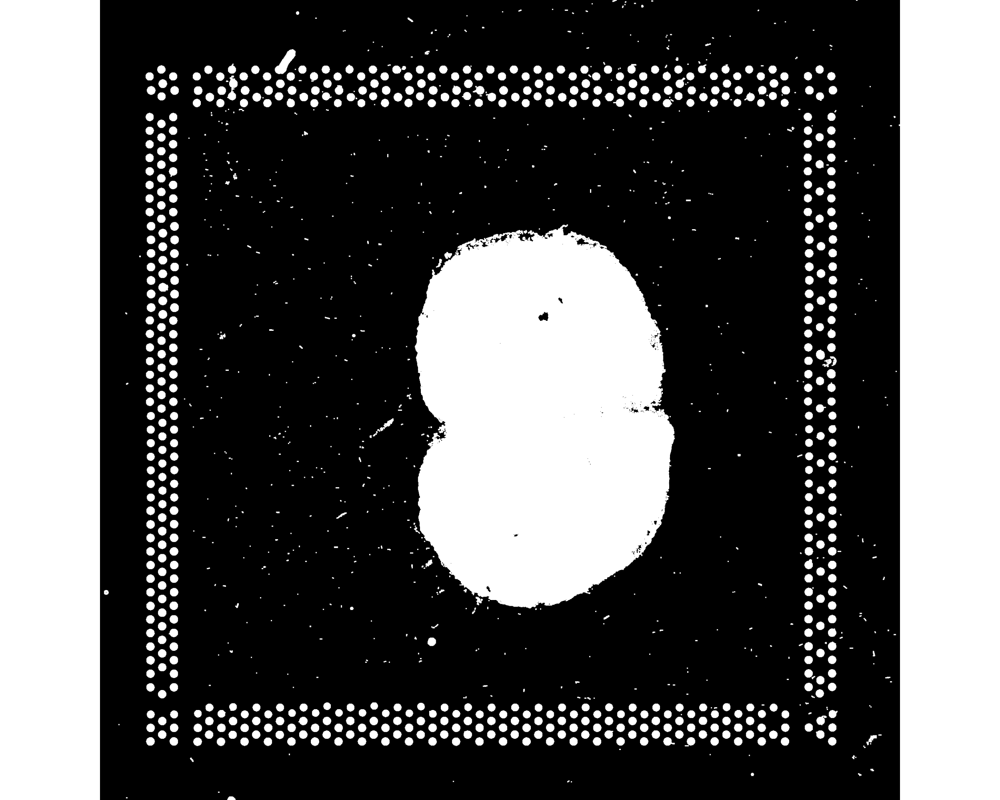

In [10]:
mask <- img2[,,3] < 0.87
kern <- EBImage::makeBrush(3, shape='disc')
mask_open <- EBImage::opening(mask, kern)
mask_close <- EBImage::closing(mask_open, kern)
EBImage::display(mask_open)

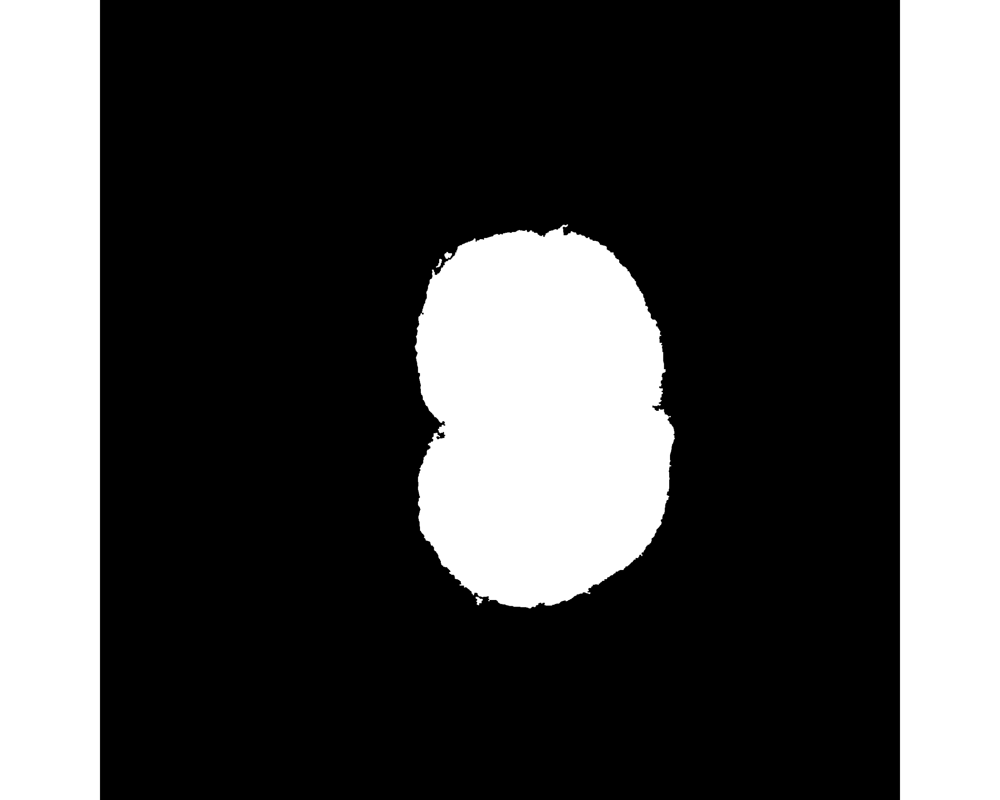

In [11]:
mask_label <- EBImage::bwlabel(mask_close)
fts <- EBImage::computeFeatures.shape(mask_label)
max_ind <- terra::which.max(fts[,"s.area"])
inds <- which(as.array(mask_label) == max_ind, arr.ind = TRUE)
row_inds <- c(seq_len(min(inds[,1])-1), seq(max(inds[,1])+1, nrow(mask_label), by = 1))
col_inds <- c(seq_len(min(inds[,2])-1), seq(max(inds[,2])+1, nrow(mask_label), by = 1))
mask_label[row_inds, ] <- 0
mask_label[,col_inds] <- 0
fts2 <- fts[unique(as.vector(mask_label))[-1],]
fts2 <- fts2[order(fts2[,"s.area"], decreasing = TRUE),]
mask_label[mask_label %in% c(797, as.numeric(rownames(fts2)[fts2[,1] < 100]))] <- 0
mask_label <- EBImage::fillHull(mask_label)
EBImage::display(mask_label)

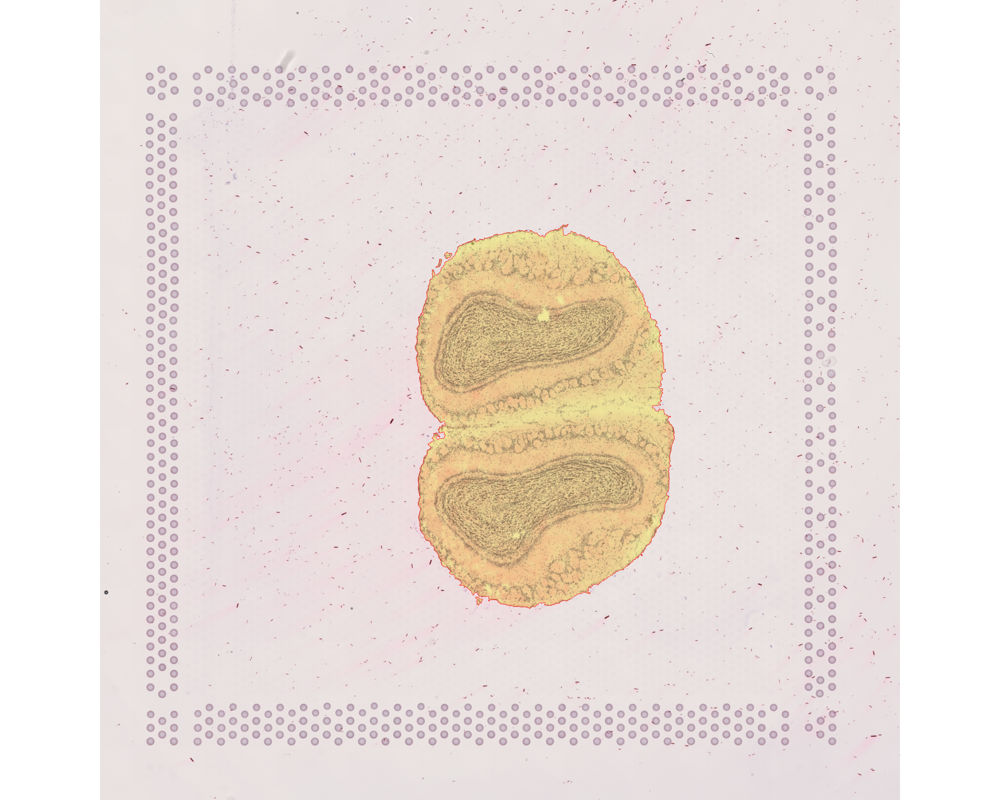

In [12]:
display(paintObjects(mask_label, img, col=c("red", "yellow"), opac=c(1, 0.3)))

In [13]:
raster2polygon <- function(seg, keep = 0.2) {
    seg <- flip(seg)
    r <- terra::rast(as.array(seg), extent = ext(0, nrow(seg), 0, ncol(seg))) |> trans()
    r[r < 1] <- NA
    contours <- st_as_sf(as.polygons(r, dissolve = TRUE))
    simplified <- ms_simplify(contours, keep = keep)
    return(list(full = contours, simplified = simplified))
}

In [14]:
tb <- raster2polygon(mask_label)
tb

,lyr.1,geometry
,<int>,<POLYGON>
1,421,"POLYGON ((1072 1521, 1072 1..."
2,450,"POLYGON ((865 647, 865 646,..."
3,461,"POLYGON ((840 669, 840 666,..."
4,849,"POLYGON ((945 1513, 945 151..."
,lyr.1,geometry
,<int>,<POLYGON>
1,421,"POLYGON ((1072 1521, 1066 1..."
2,450,"POLYGON ((865 647, 861 640,..."
3,461,"POLYGON ((840 669, 848 658,..."


In [15]:
scale_factors <- fromJSON(file = glue::glue("{mouse_dir}/spatial/scalefactors_json.json"))
tb$simplified$geometry <- tb$simplified$geometry / scale_factors$tissue_hires_scalef

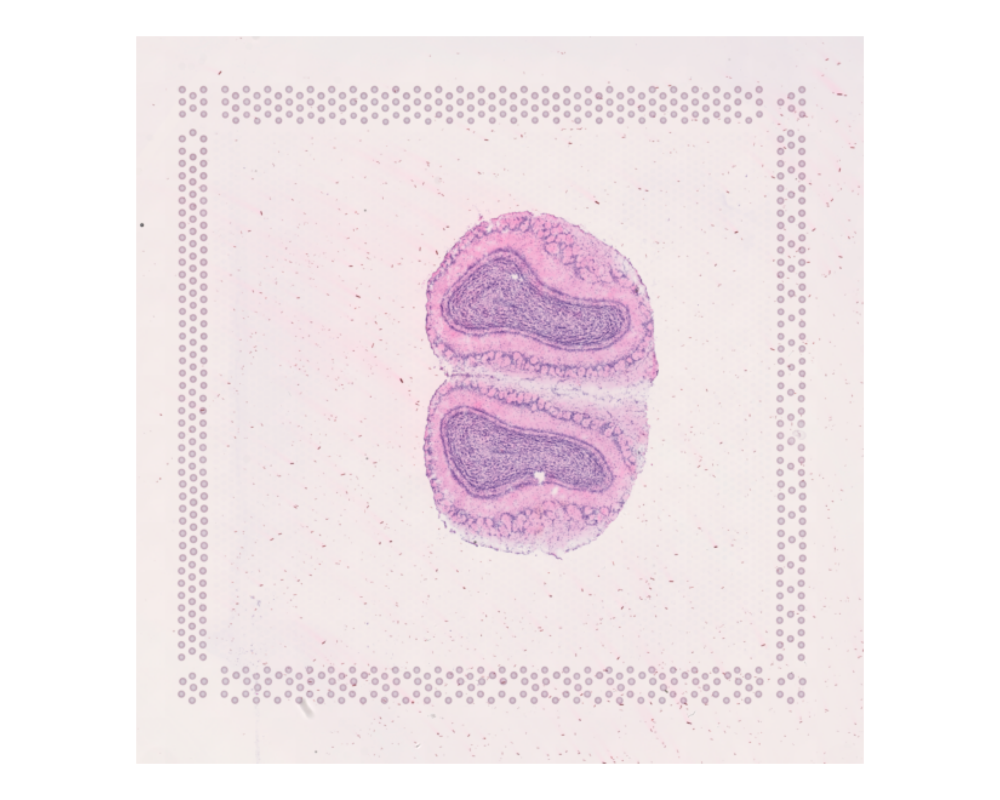

In [16]:
Voyager::plotImage(raw_sfe)

In [17]:
is_mt <- str_detect(rowData(raw_sfe)$symbol, "^mt-")
sum(is_mt)

[1] 13

In [18]:
segmented_sfe <- scuttle::addPerCellQCMetrics(raw_sfe, subsets = list(mito = is_mt))
colData(segmented_sfe)$nCounts <- colSums(counts(segmented_sfe))

In [19]:
SpatialFeatureExperiment::tissueBoundary(segmented_sfe) <- tb$simplified

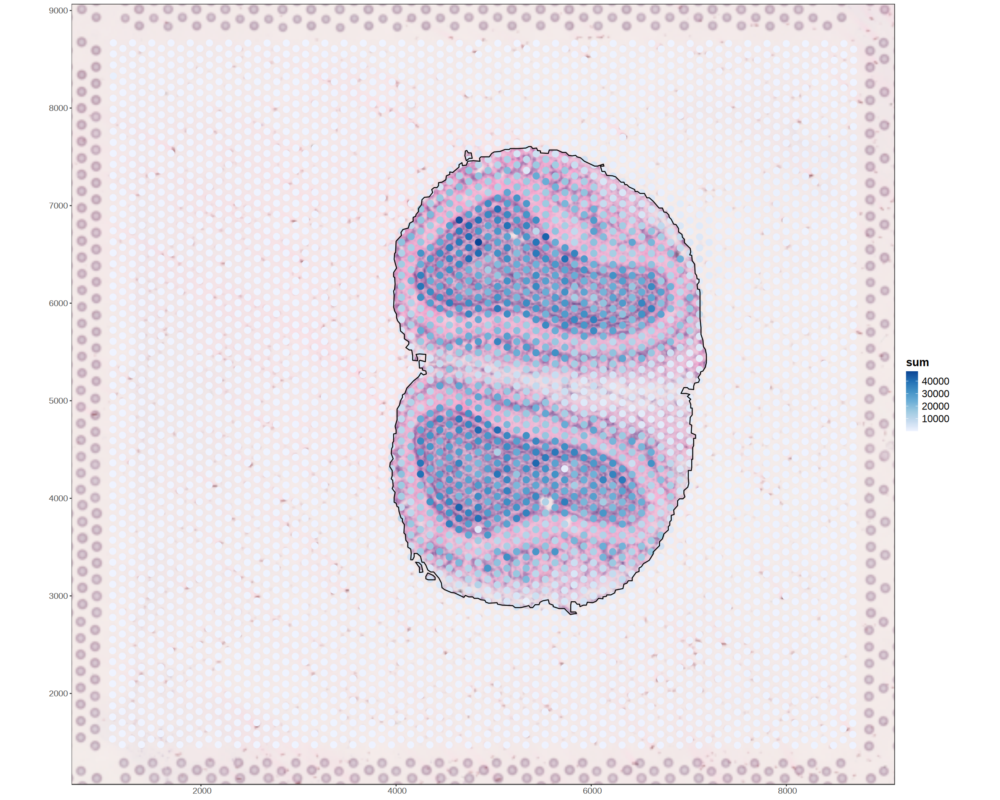

In [20]:
Voyager::plotSpatialFeature(segmented_sfe, "sum", annotGeometryName = "tissueBoundary", 
                   annot_fixed = list(fill = NA, color = "black"),
                   image_id = "lowres") + custom_theme()

In [21]:
segmented_sfe <- SpatialFeatureExperiment::transpose(segmented_sfe)

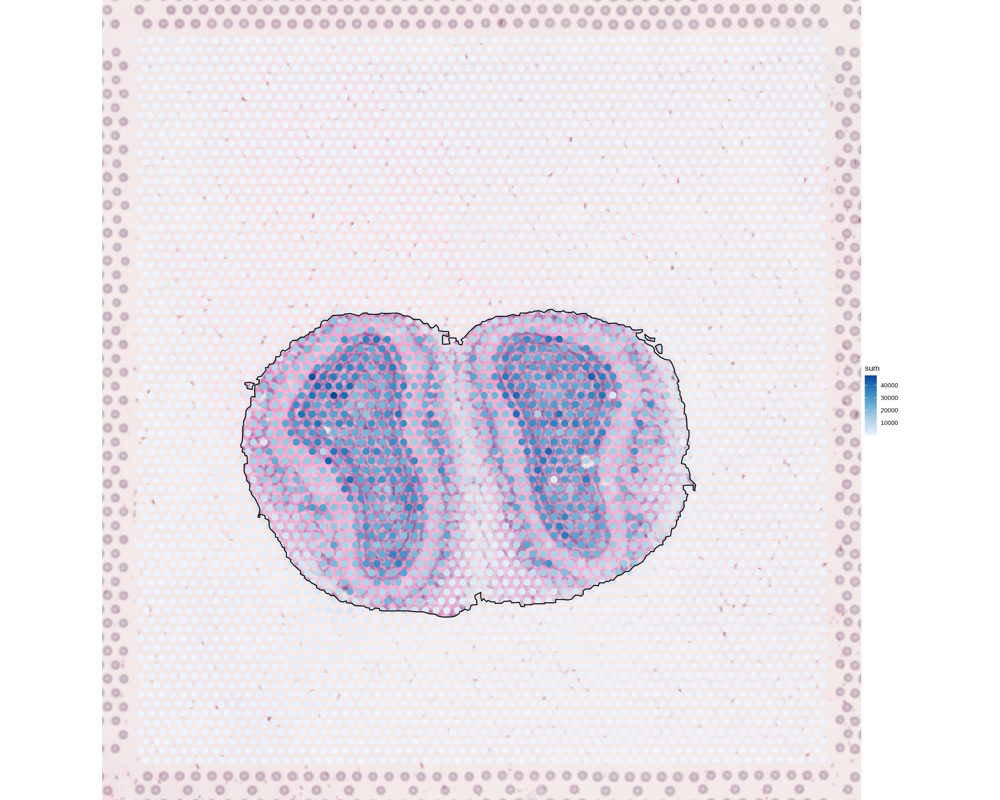

In [22]:
Voyager::plotSpatialFeature(segmented_sfe, "sum", annotGeometryName = "tissueBoundary", 
                   annot_fixed = list(fill = NA, color = "black"),
                   image_id = "lowres")

In [23]:
segmented_sfe$int_tissue <- SpatialFeatureExperiment::annotPred(segmented_sfe, colGeometryName = "spotPoly", 
                            annotGeometryName = "tissueBoundary",
                            pred = st_intersects)
segmented_sfe$cov_tissue <- SpatialFeatureExperiment::annotPred(segmented_sfe, colGeometryName = "spotPoly", 
                            annotGeometryName = "tissueBoundary",
                            pred = st_covered_by)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


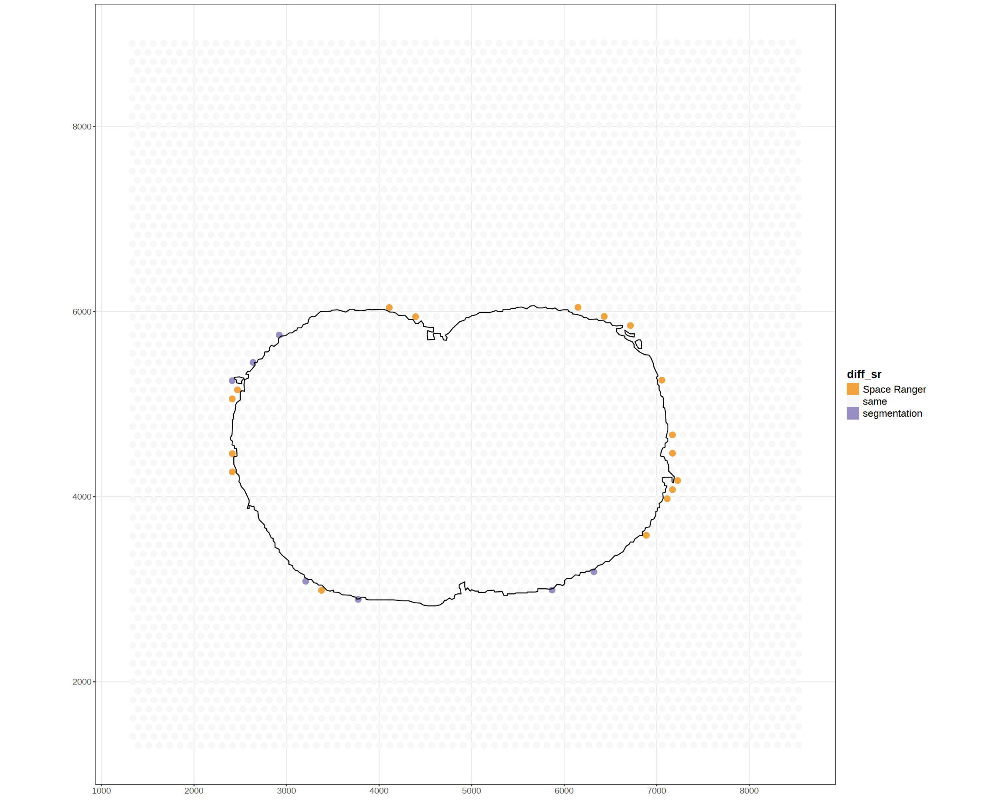

In [24]:
segmented_sfe$diff_sr <- 
    dplyr::case_when(
        segmented_sfe$in_tissue == segmented_sfe$int_tissue ~ "same",
        segmented_sfe$in_tissue & !segmented_sfe$int_tissue ~ "Space Ranger",
        segmented_sfe$int_tissue & !segmented_sfe$in_tissue ~ "segmentation"
    ) |> 
    factor(levels = c("Space Ranger", "same", "segmentation"))
Voyager::plotSpatialFeature(
    segmented_sfe, "diff_sr", 
    annotGeometryName = "tissueBoundary", 
    annot_fixed = list(fill = NA, size = 0.5, color = "black")) +
    scale_fill_brewer(type = "div", palette = 4) + custom_theme()

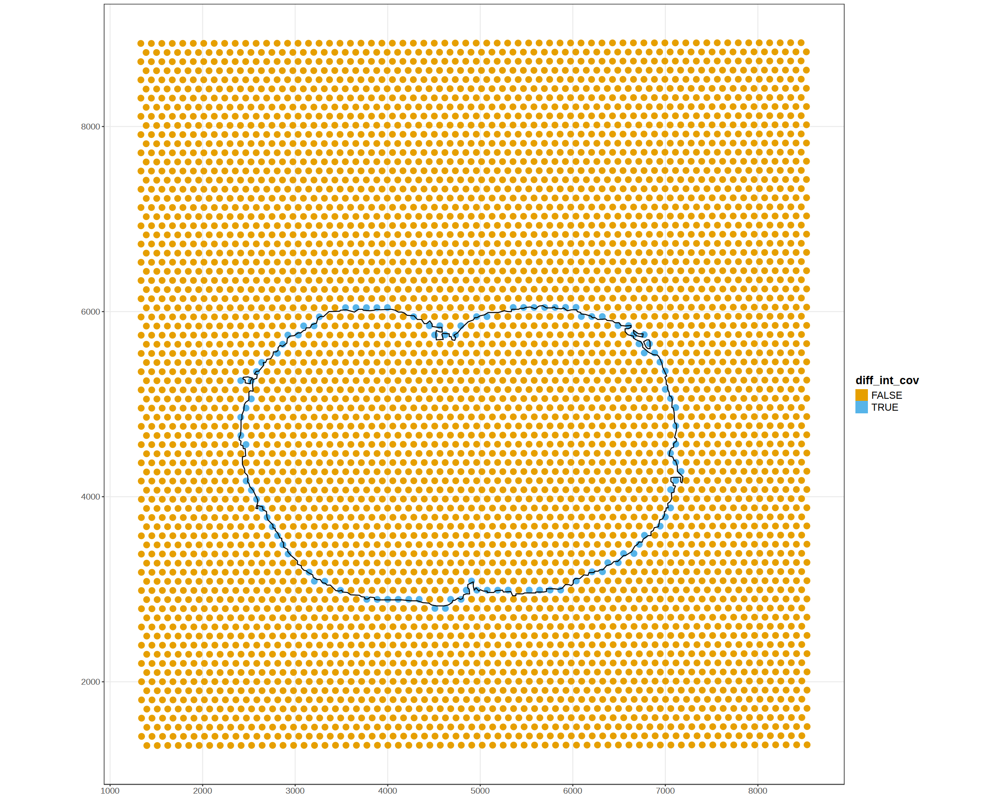

In [25]:
segmented_sfe$diff_int_cov <- segmented_sfe$int_tissue != segmented_sfe$cov_tissue
Voyager::plotSpatialFeature(
    segmented_sfe, 
    "diff_int_cov", 
    annotGeometryName = "tissueBoundary", 
    annot_fixed = list(fill = NA, size = 0.5, color = "black")) + custom_theme()

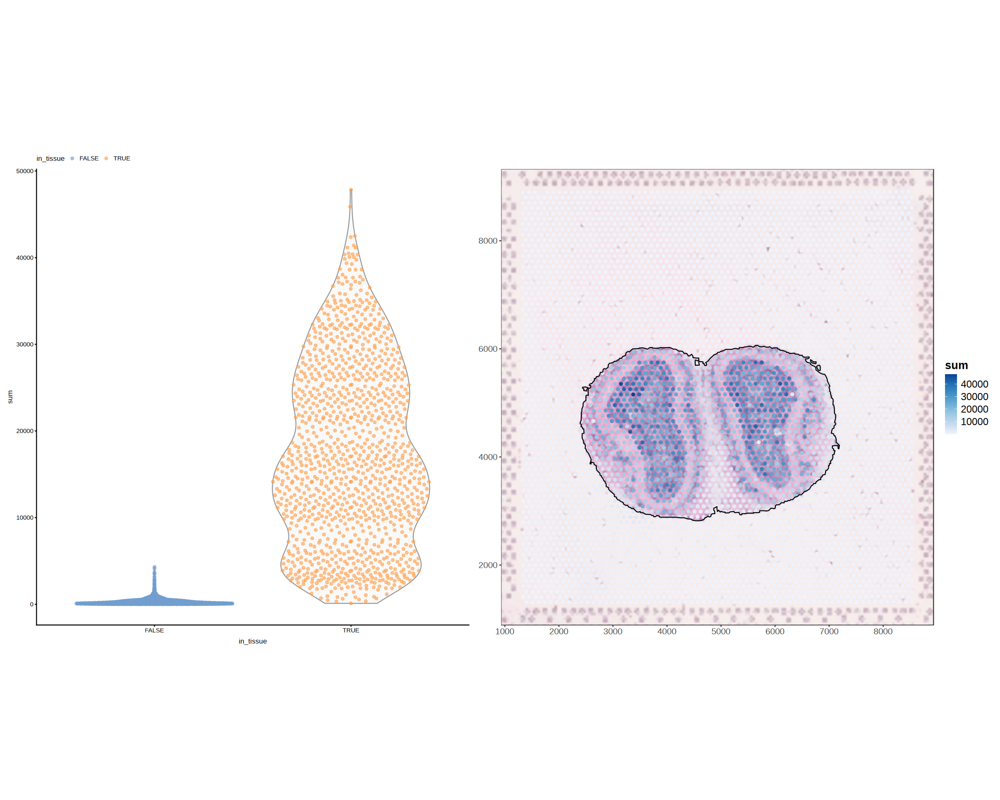

In [26]:
# colData(sfe)$nCounts <- colSums(counts(sfe))
violin <- plotColData(segmented_sfe, "sum", x = "in_tissue", colour_by = "in_tissue") +
    theme(legend.position = "top")
spatial <- plotSpatialFeature(segmented_sfe, "sum", colGeometryName = "spotPoly",
                              annotGeometryName = "tissueBoundary", 
                              image = "lowres", maxcell = 5e4,
                              annot_fixed = list(fill = NA, color = "black")) +
    custom_theme()
violin + spatial

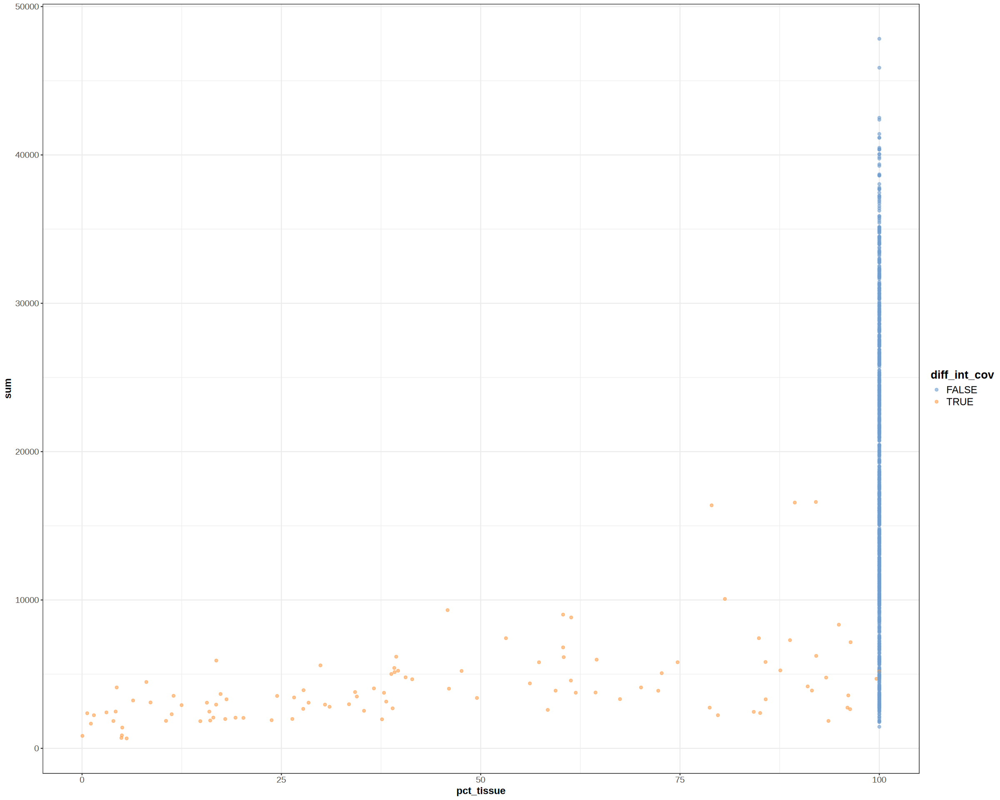

In [27]:
spot_ints <- annotOp(segmented_sfe, colGeometryName = "spotPoly", annotGeometryName = "tissueBoundary", op = st_intersection)
segmented_sfe$pct_tissue <- st_area(spot_ints) / st_area(spotPoly(segmented_sfe)) * 100
sfe_tissue <- segmented_sfe[, segmented_sfe$int_tissue]
scater::plotColData(sfe_tissue, x = "pct_tissue", y = "sum", color_by = "diff_int_cov") + custom_theme()

In [28]:
data_dir <- R.utils::getAbsolutePath('../../data')
saveRDS(segmented_sfe, glue::glue("{data_dir}/Visium_Mouse_Olfactory_Bulb.rds"))